In [3]:
import os
import pickle
def initialize_data(tissue_type):
    #corrected
    import pandas as pd
    import numpy as np

# Paths to input files
    blood_file = '/shares/sinha/epallapotu/blood_expression_project/gene_tpm_v10_whole_blood.gct.gz'
    protein_file = '/shares/sinha/epallapotu/blood_expression_project/gene_with_protein_product.txt'
    delta_file = '/shares/sinha/epallapotu/blood_expression_project/all_tissues_delta_scores.tsv'

    # Load data
    protein_data = pd.read_csv(protein_file, sep='\t')
    blood_data = pd.read_csv(blood_file, sep='\t', compression='gzip', skiprows=2)

    # Keep only genes present in both protein list and blood data
    common_genes = np.intersect1d(protein_data["symbol"], blood_data["Description"])
    blood_protein_data = blood_data[blood_data['Description'].isin(common_genes)]

    # Truncate column names (patient IDs) to first 9 characters
    blood_protein_data.columns = [col[:9] if len(col) >= 9 else col for col in blood_protein_data.columns]
    blood_protein_data = blood_protein_data.rename(columns={'Descripti': 'Description'})  # Fix truncation from previous line

    # Resolve duplicate patient columns by averaging
    blood_protein_data = (
        blood_protein_data
        .set_index(['Name', 'Description'])
        .groupby(level=0, axis=1)
        .mean()
        .reset_index()
    )

    # Read and process delta data
    delta_data = pd.read_csv(delta_file, sep='\t')
    delta_data["Patients"] = delta_data["sample_id"].str[:9]
    delta_data = delta_data.drop(columns='sample_id')
    tissue_data = delta_data[delta_data["tissue"] == (tissue_type)]

    return blood_protein_data, tissue_data, protein_data, delta_data


In [4]:
import os
import pickle
from tqdm import tqdm
from concurrent.futures import ProcessPoolExecutor
import numpy as np
import random
from scipy.stats import pearsonr

def shuffle_and_compute(args):
    count, blood_protein_data_filtered, original_data2 = args
    shuffled_data2 = original_data2.copy()
    random.shuffle(shuffled_data2)

    random_pearson_list = []
    for _, row in blood_protein_data_filtered.iterrows():
        data1 = row.values
        mask = np.isfinite(data1) & np.isfinite(shuffled_data2)
        data1 = data1[mask]
        data2 = shuffled_data2[mask]
        if len(data1) < 2 or np.std(data1) == 0 or np.std(data2) == 0:
            continue
        try:
            corr, _ = pearsonr(data1, data2)
            random_pearson_list.append(corr)
        except Exception:
            continue

    if random_pearson_list:
        return max(random_pearson_list), min(random_pearson_list)
    else:
        return None


In [5]:
import os
import pickle
from tqdm import tqdm
from concurrent.futures import ProcessPoolExecutor

def run_and_cache_shuffle(blood_protein_data_filtered, original_data2, n_iter=100, tissue_type="default"):
    os.makedirs("cached_shuffle_results", exist_ok=True)
    cache_file = f"cached_shuffle_results/shuffle_results_{tissue_type}.pkl"

    if os.path.exists(cache_file):
        print(f"Loading cached shuffle results for '{tissue_type}'")
        with open(cache_file, "rb") as f:
            return pickle.load(f)

    print(f"Running shuffle_and_compute {n_iter} times and caching results for '{tissue_type}'")
    args_list = [(i, blood_protein_data_filtered, original_data2) for i in range(n_iter)]

    with ProcessPoolExecutor() as executor:
        results = list(tqdm(executor.map(shuffle_and_compute, args_list), total=n_iter))

    # Filter out None results
    results = [r for r in results if r is not None]

    with open(cache_file, "wb") as f:
        pickle.dump(results, f)

    return results


In [6]:

from scipy.stats import pearsonr
import numpy as np

def compute_pearson(args):
    index, row, data2, name, description = args

    # Remove NaNs from both vectors
    valid_mask = (~np.isnan(row)) & (~np.isnan(data2))
    x = row[valid_mask]
    y = data2[valid_mask]

    try:
        if len(x) < 2:
            return None
        corr, p = pearsonr(x, y)
        return {
            'Pearson': corr,
            'P_value': p,
            'Name': name,
            'Description': description,
        }
    except Exception:
        return None

In [7]:
import os
import pickle
from tqdm import tqdm
from concurrent.futures import ProcessPoolExecutor

def run_and_cache_pearson(blood_protein_data_filtered, data2, names, descriptions, tissue_type="default"):
    os.makedirs("cached_pearson_results", exist_ok=True)
    cache_file = f"cached_pearson_results/pearson_results_{tissue_type}.pkl"

    if os.path.exists(cache_file):
        print(f"Loading cached Pearson results for '{tissue_type}'")
        with open(cache_file, "rb") as f:
            return pickle.load(f)

    print(f"Running compute_pearson for {len(blood_protein_data_filtered)} genes in '{tissue_type}'")
    tasks = []
    for idx, (index, row) in enumerate(blood_protein_data_filtered.iterrows()):
        tasks.append((index, row.values, data2, names[idx], descriptions[idx]))

    results_list = []
    with ProcessPoolExecutor() as executor:
        for result in tqdm(executor.map(compute_pearson, tasks), total=len(tasks)):
            if result:
                results_list.append(result)

    with open(cache_file, "wb") as f:
        pickle.dump(results_list, f)

    return results_list


In [8]:
# def tissue_analysis(tissue_type):
#     import pandas as pd
#     import numpy as np
#     import matplotlib.pyplot as plt
#     import math
#     import statistics
#     import random
#     from concurrent.futures import ProcessPoolExecutor
#     from tqdm import tqdm
#     from scipy.stats import pearsonr

#     # Load data
#     blood_protein_data, tissue_data, protein_data, delta_data = initialize_data(tissue_type)

#     # Reshape delta values to per-patient format
#     new_df = tissue_data[['Patients', 'delta']]
#     delta_data_patient = pd.DataFrame([new_df['delta'].values], columns=new_df['Patients'])
#     delta_data_patient.index = ['delta']

#     unique_cols_delta = delta_data_patient.columns.unique().to_list()
#     result_list = []

#     for col in unique_cols_delta:
#         duplicate_cols_delta = delta_data_patient.loc[:, delta_data_patient.columns == col]
#         if duplicate_cols_delta.shape[1] > 1:
#             averaged = duplicate_cols_delta.mean(axis=1)
#         else:
#             averaged = duplicate_cols_delta.iloc[:, 0]
#         result_list.append(pd.DataFrame({col: averaged}))

#     delta_data_patient = pd.concat(result_list, axis=1)

#     # Align on common patients
#     common_cols = blood_protein_data.columns.intersection(delta_data_patient.columns)
#     blood_protein_data_filtered = blood_protein_data[common_cols]
#     delta_data_patient = delta_data_patient[common_cols]
#     data2 = delta_data_patient.to_numpy().flatten()

#     # Prepare input for parallel Pearson calculation
#     tasks = []
#     for counter_gene, (index, row) in enumerate(blood_protein_data_filtered.iterrows()):
#         name = blood_protein_data["Name"].iloc[counter_gene]
#         description = blood_protein_data["Description"].iloc[counter_gene]
#         tasks.append((index, row.values, data2, name, description))

#     results_list = []
#     with ProcessPoolExecutor() as executor:
#         for result in tqdm(executor.map(compute_pearson, tasks), total=len(tasks)):
#             if result:
#                 results_list.append(result)

#     df_final_results = pd.DataFrame(results_list)

#     # Parallelized shuffle section: build null distribution
#     max_pearson_values = []
#     min_pearson_values = []
#     original_data2 = data2.copy()

#     args_list = [(count, blood_protein_data_filtered, original_data2) for count in range(100)]

#     with ProcessPoolExecutor() as executor:
#         results = list(tqdm(executor.map(shuffle_and_compute, args_list), total=100))

#     for res in results:
#         if res:
#             max_val, min_val = res
#             max_pearson_values.append(max_val)
#             min_pearson_values.append(min_val)

#     avg_max_shuffle = statistics.mean(max_pearson_values) if max_pearson_values else None
#     avg_min_shuffle = statistics.mean(min_pearson_values) if min_pearson_values else None

#     # Plot results
#     fig, ax = plt.subplots(figsize=(8, 6))
#     log_p_value_list = [-math.log(p) if p > 0 else 0 for p in df_final_results['P_value']]
#     ax.scatter(df_final_results['Pearson'], log_p_value_list)
#     ax.set_xlabel("Correlation Coefficient")
#     ax.set_ylabel("-log(p-value)")
#     ax.set_title(f"Blood Expression vs Delta - {tissue_type}")
    
#     if avg_max_shuffle is not None:
#         ax.axvline(x=avg_max_shuffle, color='red', linestyle='--', linewidth=2,
#                    label=f"Avg max if shuffled: {avg_max_shuffle:.3f}")
#     if avg_min_shuffle is not None:
#         ax.axvline(x=avg_min_shuffle, color='blue', linestyle='--', linewidth=2,
#                    label=f"Avg min if shuffled: {avg_min_shuffle:.3f}")
    
#     ax.grid(True)
#     ax.legend()
#     fig.tight_layout()

#     # Report top features
#     top_features = df_final_results.reindex(df_final_results['Pearson'].abs().sort_values(ascending=False).index)
#     top_feature_names = top_features['Name'].head(5).tolist()
#     top_feature_Description = top_features['Description'].head(5).tolist()
#     print("Top features by correlation (gene names):", top_feature_names)
#     print("Top features by correlation (protein names):", top_feature_Description)

#     return fig


In [14]:
def tissue_analysis(tissue_type):
    import pandas as pd
    import numpy as np
    import matplotlib.pyplot as plt
    import math
    import statistics
    import random
    from concurrent.futures import ProcessPoolExecutor
    from tqdm import tqdm
    from scipy.stats import pearsonr

    # Load data
    blood_protein_data, tissue_data, protein_data, delta_data = initialize_data(tissue_type)

    # Reshape delta values to per-patient format
    new_df = tissue_data[['Patients', 'delta']]
    delta_data_patient = pd.DataFrame([new_df['delta'].values], columns=new_df['Patients'])
    delta_data_patient.index = ['delta']

    unique_cols_delta = delta_data_patient.columns.unique().to_list()
    result_list = []

    for col in unique_cols_delta:
        duplicate_cols_delta = delta_data_patient.loc[:, delta_data_patient.columns == col]
        if duplicate_cols_delta.shape[1] > 1:
            averaged = duplicate_cols_delta.mean(axis=1)
        else:
            averaged = duplicate_cols_delta.iloc[:, 0]
        result_list.append(pd.DataFrame({col: averaged}))

    delta_data_patient = pd.concat(result_list, axis=1)

    # Align on common patients
    common_cols = blood_protein_data.columns.intersection(delta_data_patient.columns)
    blood_protein_data_filtered = blood_protein_data[common_cols]
    delta_data_patient = delta_data_patient[common_cols]
    data2 = delta_data_patient.to_numpy().flatten()

    # Prepare input for parallel Pearson calculation
    tasks = []
    for counter_gene, (index, row) in enumerate(blood_protein_data_filtered.iterrows()):
        name = blood_protein_data["Name"].iloc[counter_gene]
        description = blood_protein_data["Description"].iloc[counter_gene]
        tasks.append((index, row.values, data2, name, description))

    results_list = []
    with ProcessPoolExecutor() as executor:
        for result in tqdm(executor.map(compute_pearson, tasks), total=len(tasks)):
            if result:
                results_list.append(result)

    df_final_results = pd.DataFrame(results_list)
    top_features = df_final_results.reindex(df_final_results['Pearson'].abs().sort_values(ascending=False).index)
    top_feature_names = top_features['Name'].tolist()
    top_feature_Description = top_features['Description'].tolist()
        # Parallelized shuffle section: build null distribution
    max_pearson_values = []
    min_pearson_values = []
    original_data2 = data2.copy()

    args_list = [(count, blood_protein_data_filtered, original_data2) for count in range(100)]

    with ProcessPoolExecutor() as executor:
        results = list(tqdm(executor.map(shuffle_and_compute, args_list), total=100))
    print(results)
    for res in results:
        if res:
            max_val, min_val = res
            max_pearson_values.append(max_val)
            min_pearson_values.append(min_val)

    avg_max_shuffle = statistics.mean(max_pearson_values) if max_pearson_values else None
    avg_min_shuffle = statistics.mean(min_pearson_values) if min_pearson_values else None

    # Plot results
    fig, ax = plt.subplots(figsize=(8, 6))
    log_p_value_list = [-math.log(p) if p > 0 else 0 for p in df_final_results['P_value']]
    ax.scatter(df_final_results['Pearson'], log_p_value_list)
    ax.set_xlabel("Correlation Coefficient")
    ax.set_ylabel("-log(p-value)")
    ax.set_title(f"Blood Expression vs Delta - {tissue_type}")

    #to find the number of points that is above the line
    # Count points to the right of the red line (Pearson > shuffled max)
    points_right_of_line = df_final_results['Pearson'] > avg_max_shuffle
    count_above_line = points_right_of_line.sum()
    percent_above_line = (count_above_line / len(df_final_results)) * 100
    ax.text(0.75, 5, f"{percent_above_line:.2f}% genes right of shuffled max", 
            fontsize=14, color='pink', ha='center', va='bottom')

    # Count points to the left of the red line
    points_left_of_line = df_final_results['Pearson'] < avg_min_shuffle
    count_below_line = points_left_of_line.sum()
    percent_below_line = (count_below_line / len(df_final_results)) * 100
    ax.text(-0.75, 5, f"{percent_below_line:.2f}% genes left of shuffled max", 
            fontsize=14, color='green', ha='center', va='bottom')

    total_percent_out_line= percent_below_line+percent_above_line
    ax.text(0.75, 8, f"{total_percent_out_line:.2f}% genes percentage total over the line.", 
            fontsize=14, color='orange', ha='center', va='bottom')

    number_of_genes_overline= (total_percent_out_line*(len(df_final_results['Pearson'])))/100
    ax.text(-0.75, 8, f"{number_of_genes_overline:.2f} genes total over the line.", 
            fontsize=14, color='brown', ha='center', va='bottom')
    
    #number of total patients per sample
    number_of_patients= len(common_cols)
    ax.text(-0.75, 10, f"{number_of_patients:.2f} is the number of pateints in the data set", 
            fontsize=14, color='black', ha='center', va='bottom')
    
    number_of_genes_in_dataset= len(df_final_results['Pearson'])
    ax.text(0.75, 10, f"{number_of_genes_in_dataset:.2f} is the total genes being used in the data set.", 
                fontsize=14, color='grey', ha='center', va='bottom')

    if avg_max_shuffle is not None:
        ax.axvline(x=avg_max_shuffle, color='red', linestyle='--', linewidth=2,
                   label=f"Avg max if shuffled: {avg_max_shuffle:.3f}")
    else:
        print("error computing avg_max_shuffle")
    if avg_min_shuffle is not None:
        ax.axvline(x=avg_min_shuffle, color='blue', linestyle='--', linewidth=2,
                   label=f"Avg min if shuffled: {avg_min_shuffle:.3f}")
    else:
        print("error computing avg_min_shuffle")
    ax.grid(True)
    ax.legend()
    fig.tight_layout()

    # Report top features
    top_features = df_final_results.reindex(df_final_results['Pearson'].abs().sort_values(ascending=False).index)
    top_feature_names = top_features['Name'].tolist()
    top_feature_Description = top_features['Description'].tolist()
    print("Top features by correlation (gene names):", top_feature_names)
    print("Top features by correlation (protein names):", top_feature_Description)

    return fig, df_final_results, avg_max_shuffle, avg_min_shuffle, top_feature_names, top_feature_Description


In [15]:
def analyze_tissues():

    import pandas as pd
    import matplotlib.pyplot as plt

    # Load delta data once
    delta_data = pd.read_csv('/shares/sinha/epallapotu/blood_expression_project/all_tissues_delta_scores.tsv', sep='\t')
    unique_tissues = delta_data["tissue"].unique()
    print(f"These are the unique tissues found:\n{unique_tissues}\n")

    # List of tissues to analyze
    tissue_list = unique_tissues
    plot_list = []
    
    for tissue in tissue_list:
        if tissue not in unique_tissues:
            print(f"Tissue '{tissue}' not found in dataset. Skipping.")
            continue
        print(f"\n--- Running analysis for tissue: {tissue} ---")
        try:
            fig, df_final_results, avg_max_shuffle, avg_min_shuffle, top_feature_names, top_feature_Description = tissue_analysis(tissue)
            
            output_dir = f"{tissue}_analysis_results"
            os.makedirs(output_dir, exist_ok=True)
            if fig is not None:
                plot_list.append((tissue, fig))
                output_dir = f"{tissue}_analysis_results"
                os.makedirs(output_dir, exist_ok=True)
                fig_path = os.path.join(output_dir, f"{tissue}_correlation_plot.png")
                fig.savefig(fig_path)
                print(f"Saved plot to {fig_path}")

                # Save the dataframe
                csv_path = os.path.join(output_dir, f"{tissue}_correlation_results.csv")
                df_final_results.to_csv(csv_path, index=False)
                print(f"Saved results to {csv_path}")

                # Save summary stats
                stats_path = os.path.join(output_dir, f"{tissue}_summary.txt")
                with open(stats_path, 'w') as f:
                    f.write(f"Tissue: {tissue}\n")
                    f.write(f"Avg Max Shuffle: {avg_max_shuffle:.4f}\n")
                    f.write(f"Avg Min Shuffle: {avg_min_shuffle:.4f}\n")
                    f.write(f"Total genes: {len(df_final_results)}\n")

                gene_name_path = os.path.join(output_dir, f"{tissue}_geneName.txt")
                with open(gene_name_path, "w") as f:
                    f.write("\n".join(top_feature_names))
                    
                gene_description_path = os.path.join(output_dir, f"{tissue}_geneDescription.txt")
                with open(gene_description_path, "w") as f:
                    f.write("\n".join(top_feature_Description))

                print(f"Saved summary to {stats_path}")
            else:
                print(f" No figure returned for tissue '{tissue}'.")
        except Exception as e:
            print(f"Error processing tissue '{tissue}': {e}")
        
       
    # Show all collected plots
    for tissue, fig in plot_list:
        print(f" Showing plot for: {tissue}")
        plt.figure(fig.number)
        plt.show()


These are the unique tissues found:
['Adipose - Subcutaneous' 'Adrenal Gland' 'Artery - Aorta'
 'Artery - Coronary' 'Artery - Tibial' 'Brain - Cerebellum'
 'Brain - Cortex' 'Breast - Mammary Tissue' 'Colon - Sigmoid'
 'Colon - Transverse' 'Esophagus - Gastroesophageal Junction'
 'Esophagus - Mucosa' 'Esophagus - Muscularis' 'Heart - Atrial Appendage'
 'Heart - Left Ventricle' 'Kidney - Cortex' 'Liver' 'Lung'
 'Muscle - Skeletal' 'Nerve - Tibial' 'Ovary' 'Pancreas' 'Pituitary'
 'Prostate' 'Small Intestine - Terminal Ileum' 'Spleen' 'Stomach' 'Testis'
 'Thyroid' 'Uterus' 'Vagina']


--- Running analysis for tissue: Adipose - Subcutaneous ---


/tmp/ipykernel_3827095/985918198.py:14: DtypeWarning: Columns (35,38,45,48,49) have mixed types. Specify dtype option on import or set low_memory=False.
  protein_data = pd.read_csv(protein_file, sep='\t')
/tmp/ipykernel_3827095/985918198.py:29: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  .groupby(level=0, axis=1)
  5%|▍         | 882/18917 [00:00<00:05, 3233.61it/s]/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
  9%|▉         | 1777/18917 [00:00<00:04, 3851.68it/s]/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
 12%|█▏        | 2221/189

[(np.float64(0.1688530414688032), np.float64(-0.13960050738549243)), (np.float64(0.15361391351636017), np.float64(-0.11301940722253168)), (np.float64(0.22626878567700429), np.float64(-0.15361462592604563)), (np.float64(0.14715450824848242), np.float64(-0.14064111446525596)), (np.float64(0.1921905411743039), np.float64(-0.12417485826813127)), (np.float64(0.19061082497412096), np.float64(-0.15040335167528002)), (np.float64(0.15697807702149724), np.float64(-0.1719918937445501)), (np.float64(0.19834235615429563), np.float64(-0.13284691708403912)), (np.float64(0.2142580247385717), np.float64(-0.12953799714813682)), (np.float64(0.21138746149796933), np.float64(-0.1232373896232502)), (np.float64(0.20029264485897535), np.float64(-0.16092745010569037)), (np.float64(0.17788347607924548), np.float64(-0.1396857160873911)), (np.float64(0.18069015215382278), np.float64(-0.13047111923336624)), (np.float64(0.19659840552548924), np.float64(-0.14407813784931436)), (np.float64(0.18674665866173787), np.fl

/tmp/ipykernel_3827095/2616738495.py:127: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  fig.tight_layout()


Saved plot to Adipose - Subcutaneous_analysis_results/Adipose - Subcutaneous_correlation_plot.png
Saved results to Adipose - Subcutaneous_analysis_results/Adipose - Subcutaneous_correlation_results.csv
Saved summary to Adipose - Subcutaneous_analysis_results/Adipose - Subcutaneous_summary.txt

--- Running analysis for tissue: Adrenal Gland ---


/tmp/ipykernel_3827095/985918198.py:14: DtypeWarning: Columns (35,38,45,48,49) have mixed types. Specify dtype option on import or set low_memory=False.
  protein_data = pd.read_csv(protein_file, sep='\t')
/tmp/ipykernel_3827095/985918198.py:29: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  .groupby(level=0, axis=1)
  5%|▌         | 959/18917 [00:00<00:04, 3668.25it/s]/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
 11%|█▏        | 2146/18917 [00:00<00:04, 3835.06it/s]/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
/tmp/ipykernel_3827095/22

[(np.float64(0.2151762718502959), np.float64(-0.12106393842673963)), (np.float64(0.23139315316995668), np.float64(-0.1508648030622382)), (np.float64(0.24486923370042363), np.float64(-0.1725404537680705)), (np.float64(0.20525830805251513), np.float64(-0.13238098066011988)), (np.float64(0.18620016571445772), np.float64(-0.14690125670388965)), (np.float64(0.21681841338421298), np.float64(-0.15891417024941284)), (np.float64(0.31512166319998136), np.float64(-0.13241044182440953)), (np.float64(0.2172404067643762), np.float64(-0.1479892801791482)), (np.float64(0.20556321097041777), np.float64(-0.1556938321509914)), (np.float64(0.21508248737737357), np.float64(-0.15956779850222197)), (np.float64(0.20442791205505423), np.float64(-0.1450090403692218)), (np.float64(0.2683929492934333), np.float64(-0.17014908507506585)), (np.float64(0.20205131346870103), np.float64(-0.14618423806069283)), (np.float64(0.21635430245323775), np.float64(-0.1380815922225865)), (np.float64(0.19948822744543193), np.float

/tmp/ipykernel_3827095/2616738495.py:127: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  fig.tight_layout()


Saved plot to Adrenal Gland_analysis_results/Adrenal Gland_correlation_plot.png
Saved results to Adrenal Gland_analysis_results/Adrenal Gland_correlation_results.csv
Saved summary to Adrenal Gland_analysis_results/Adrenal Gland_summary.txt

--- Running analysis for tissue: Artery - Aorta ---


/tmp/ipykernel_3827095/985918198.py:14: DtypeWarning: Columns (35,38,45,48,49) have mixed types. Specify dtype option on import or set low_memory=False.
  protein_data = pd.read_csv(protein_file, sep='\t')
/tmp/ipykernel_3827095/985918198.py:29: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  .groupby(level=0, axis=1)
  5%|▍         | 894/18917 [00:00<00:05, 3367.35it/s]/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
 10%|█         | 1906/18917 [00:00<00:03, 4345.53it/s]/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
 12%|█▏        | 2341/189

[(np.float64(0.2071857602205343), np.float64(-0.14712956188277707)), (np.float64(0.19685245423641887), np.float64(-0.146788250582437)), (np.float64(0.20527544239699927), np.float64(-0.14894195772687222)), (np.float64(0.20118983196247428), np.float64(-0.12388641074304327)), (np.float64(0.2544562094497312), np.float64(-0.14811724780341032)), (np.float64(0.18583276910990879), np.float64(-0.14398995859664565)), (np.float64(0.2119713600057585), np.float64(-0.15704335558231192)), (np.float64(0.18802089063250482), np.float64(-0.1385271253868682)), (np.float64(0.22286702124244062), np.float64(-0.1258967398107113)), (np.float64(0.19697920216561862), np.float64(-0.13231457647739514)), (np.float64(0.2514341084782586), np.float64(-0.13083261748041836)), (np.float64(0.25511450684095655), np.float64(-0.1290698192313527)), (np.float64(0.20561473752639595), np.float64(-0.1476381334379469)), (np.float64(0.24526087673519825), np.float64(-0.1532423946275917)), (np.float64(0.21732208410307885), np.float64

/tmp/ipykernel_3827095/2616738495.py:127: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  fig.tight_layout()


Saved plot to Artery - Aorta_analysis_results/Artery - Aorta_correlation_plot.png
Saved results to Artery - Aorta_analysis_results/Artery - Aorta_correlation_results.csv
Saved summary to Artery - Aorta_analysis_results/Artery - Aorta_summary.txt

--- Running analysis for tissue: Artery - Coronary ---


/tmp/ipykernel_3827095/985918198.py:14: DtypeWarning: Columns (35,38,45,48,49) have mixed types. Specify dtype option on import or set low_memory=False.
  protein_data = pd.read_csv(protein_file, sep='\t')
/tmp/ipykernel_3827095/985918198.py:29: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  .groupby(level=0, axis=1)
  5%|▌         | 986/18917 [00:00<00:05, 3489.14it/s]/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
 10%|█         | 1944/18917 [00:00<00:04, 4222.33it/s]/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
 13%|█▎        | 2368/189

[(np.float64(0.18857911137046737), np.float64(-0.16935919888748047)), (np.float64(0.18618735179910267), np.float64(-0.16581839844438118)), (np.float64(0.20051028579289676), np.float64(-0.16025616391223432)), (np.float64(0.17885360501462752), np.float64(-0.16088329682953248)), (np.float64(0.186307497399987), np.float64(-0.18324384272327454)), (np.float64(0.17871534534633746), np.float64(-0.2144385598613316)), (np.float64(0.20238789067527868), np.float64(-0.15382044046473825)), (np.float64(0.209094250194554), np.float64(-0.17502461428876917)), (np.float64(0.2060638353226797), np.float64(-0.16252890077608814)), (np.float64(0.19200691605782358), np.float64(-0.1944094719044289)), (np.float64(0.1981429716888723), np.float64(-0.1740603044601484)), (np.float64(0.18329311779649393), np.float64(-0.16844040809555005)), (np.float64(0.198544248213903), np.float64(-0.19578946927447197)), (np.float64(0.2013106844303253), np.float64(-0.18640237478358496)), (np.float64(0.1665012404837005), np.float64(-

/tmp/ipykernel_3827095/2616738495.py:127: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  fig.tight_layout()


Saved plot to Artery - Coronary_analysis_results/Artery - Coronary_correlation_plot.png
Saved results to Artery - Coronary_analysis_results/Artery - Coronary_correlation_results.csv
Saved summary to Artery - Coronary_analysis_results/Artery - Coronary_summary.txt

--- Running analysis for tissue: Artery - Tibial ---


/tmp/ipykernel_3827095/985918198.py:14: DtypeWarning: Columns (35,38,45,48,49) have mixed types. Specify dtype option on import or set low_memory=False.
  protein_data = pd.read_csv(protein_file, sep='\t')
/tmp/ipykernel_3827095/985918198.py:29: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  .groupby(level=0, axis=1)
  3%|▎         | 567/18917 [00:00<00:05, 3090.28it/s]/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
  8%|▊         | 1562/18917 [00:00<00:04, 4294.75it/s]/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
 11%|█         | 2045/18917 [00:00<00:03, 4453.67it/s]/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined

[(np.float64(0.16398946953851773), np.float64(-0.12146241803983324)), (np.float64(0.21196404070544114), np.float64(-0.1327036732853292)), (np.float64(0.197990278310893), np.float64(-0.1322837981999863)), (np.float64(0.1756401469665791), np.float64(-0.13465515862113184)), (np.float64(0.15151361546110126), np.float64(-0.12710829904290336)), (np.float64(0.18370915032092983), np.float64(-0.13936427023247427)), (np.float64(0.158696276644889), np.float64(-0.16878750847003982)), (np.float64(0.1709347123547776), np.float64(-0.12893188254954926)), (np.float64(0.13995910413668433), np.float64(-0.1382279293486535)), (np.float64(0.2020817830726827), np.float64(-0.13742009321777335)), (np.float64(0.20488836166195468), np.float64(-0.15899930841160795)), (np.float64(0.1837092085591092), np.float64(-0.1479981227495012)), (np.float64(0.19098011363753542), np.float64(-0.13294394811646193)), (np.float64(0.22482329831777786), np.float64(-0.13660897926086696)), (np.float64(0.2089436467356155), np.float64(-

/tmp/ipykernel_3827095/2616738495.py:127: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  fig.tight_layout()


Saved plot to Artery - Tibial_analysis_results/Artery - Tibial_correlation_plot.png
Saved results to Artery - Tibial_analysis_results/Artery - Tibial_correlation_results.csv
Saved summary to Artery - Tibial_analysis_results/Artery - Tibial_summary.txt

--- Running analysis for tissue: Brain - Cerebellum ---


/tmp/ipykernel_3827095/985918198.py:14: DtypeWarning: Columns (35,38,45,48,49) have mixed types. Specify dtype option on import or set low_memory=False.
  protein_data = pd.read_csv(protein_file, sep='\t')
/tmp/ipykernel_3827095/985918198.py:29: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  .groupby(level=0, axis=1)
  6%|▌         | 1044/18917 [00:00<00:04, 3951.60it/s]/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
  8%|▊         | 1514/18917 [00:00<00:04, 4127.98it/s]/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
 11%|█         | 2054/18

[(np.float64(0.2727155193037291), np.float64(-0.20904040735755702)), (np.float64(0.29387805244040216), np.float64(-0.25972012997677874)), (np.float64(0.27271551930372917), np.float64(-0.19898939220701728)), (np.float64(0.32378172105405095), np.float64(-0.20319358633665802)), (np.float64(0.24362570619233048), np.float64(-0.2040458689700512)), (np.float64(0.25938351711369806), np.float64(-0.2411446501570227)), (np.float64(0.2727155193037292), np.float64(-0.22670131817190842)), (np.float64(0.32156863564794474), np.float64(-0.1933225924927153)), (np.float64(0.29555187532326915), np.float64(-0.24651117048816684)), (np.float64(0.2932692869013483), np.float64(-0.1915056763789269)), (np.float64(0.33912172319569023), np.float64(-0.24289873798251999)), (np.float64(0.29352160923793275), np.float64(-0.23273928081174072)), (np.float64(0.2946566427275822), np.float64(-0.1944236050881286)), (np.float64(0.40316922631805535), np.float64(-0.2300969845720791)), (np.float64(0.30679723244506113), np.float6

/tmp/ipykernel_3827095/2616738495.py:127: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  fig.tight_layout()


Saved plot to Brain - Cerebellum_analysis_results/Brain - Cerebellum_correlation_plot.png
Saved results to Brain - Cerebellum_analysis_results/Brain - Cerebellum_correlation_results.csv
Saved summary to Brain - Cerebellum_analysis_results/Brain - Cerebellum_summary.txt

--- Running analysis for tissue: Brain - Cortex ---


/tmp/ipykernel_3827095/985918198.py:14: DtypeWarning: Columns (35,38,45,48,49) have mixed types. Specify dtype option on import or set low_memory=False.
  protein_data = pd.read_csv(protein_file, sep='\t')
/tmp/ipykernel_3827095/985918198.py:29: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  .groupby(level=0, axis=1)
  5%|▍         | 922/18917 [00:00<00:05, 3331.02it/s]/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
 11%|█         | 2013/18917 [00:00<00:03, 4629.65it/s]/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
 13%|█▎        | 2526/189

[(np.float64(0.2664830311268648), np.float64(-0.2683145091107289)), (np.float64(0.24384157197961046), np.float64(-0.23415608698821633)), (np.float64(0.3174145922533522), np.float64(-0.2285295180890684)), (np.float64(0.2780954788985585), np.float64(-0.21224860492921527)), (np.float64(0.26648303112686483), np.float64(-0.23131141812341605)), (np.float64(0.3637854921064604), np.float64(-0.24203448203447467)), (np.float64(0.2886106512833357), np.float64(-0.2758336212003245)), (np.float64(0.2615558555039304), np.float64(-0.3049539306053191)), (np.float64(0.25540456138363093), np.float64(-0.20186024287607318)), (np.float64(0.3007590976197033), np.float64(-0.22868814599628362)), (np.float64(0.2603648943699014), np.float64(-0.2655816741401312)), (np.float64(0.28016838300174934), np.float64(-0.24716397680561059)), (np.float64(0.2645271966106257), np.float64(-0.21857838382970815)), (np.float64(0.2664830311268648), np.float64(-0.18377793805904738)), (np.float64(0.26707371188305645), np.float64(-0.

/tmp/ipykernel_3827095/2616738495.py:127: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  fig.tight_layout()


Saved plot to Brain - Cortex_analysis_results/Brain - Cortex_correlation_plot.png
Saved results to Brain - Cortex_analysis_results/Brain - Cortex_correlation_results.csv
Saved summary to Brain - Cortex_analysis_results/Brain - Cortex_summary.txt

--- Running analysis for tissue: Breast - Mammary Tissue ---


/tmp/ipykernel_3827095/985918198.py:14: DtypeWarning: Columns (35,38,45,48,49) have mixed types. Specify dtype option on import or set low_memory=False.
  protein_data = pd.read_csv(protein_file, sep='\t')
/tmp/ipykernel_3827095/985918198.py:29: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  .groupby(level=0, axis=1)
  7%|▋         | 1298/18917 [00:00<00:04, 3551.59it/s]/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
 11%|█         | 2030/18917 [00:00<00:04, 3620.06it/s]/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
 13%|█▎        | 2408/18

[(np.float64(0.13697256279346195), np.float64(-0.12413778022732036)), (np.float64(0.17180605130378196), np.float64(-0.12558046584727178)), (np.float64(0.1617956891157615), np.float64(-0.1748637309356766)), (np.float64(0.18219930862843625), np.float64(-0.16037923565634638)), (np.float64(0.18053156855292918), np.float64(-0.16494942824403536)), (np.float64(0.1980255404877517), np.float64(-0.17964801924246204)), (np.float64(0.16159527761046755), np.float64(-0.13900987903861084)), (np.float64(0.1641345169532109), np.float64(-0.15313796815572744)), (np.float64(0.15191905986523374), np.float64(-0.13904679239896267)), (np.float64(0.13794654136791523), np.float64(-0.14862065035501973)), (np.float64(0.18107993279350498), np.float64(-0.15456113784424713)), (np.float64(0.19846994948115118), np.float64(-0.16367075279809776)), (np.float64(0.15082467984925188), np.float64(-0.14861631261461913)), (np.float64(0.20118052731311087), np.float64(-0.1263236581140679)), (np.float64(0.2109395876822318), np.fl

/tmp/ipykernel_3827095/2616738495.py:127: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  fig.tight_layout()


Saved plot to Breast - Mammary Tissue_analysis_results/Breast - Mammary Tissue_correlation_plot.png
Saved results to Breast - Mammary Tissue_analysis_results/Breast - Mammary Tissue_correlation_results.csv
Saved summary to Breast - Mammary Tissue_analysis_results/Breast - Mammary Tissue_summary.txt

--- Running analysis for tissue: Colon - Sigmoid ---


/tmp/ipykernel_3827095/985918198.py:14: DtypeWarning: Columns (35,38,45,48,49) have mixed types. Specify dtype option on import or set low_memory=False.
  protein_data = pd.read_csv(protein_file, sep='\t')
/tmp/ipykernel_3827095/985918198.py:29: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  .groupby(level=0, axis=1)
  6%|▌         | 1116/18917 [00:00<00:04, 3923.19it/s]/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
 10%|█         | 1933/18917 [00:00<00:04, 3979.52it/s]/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
 12%|█▏        | 2332/18

[(np.float64(0.2510110882472787), np.float64(-0.13197450642571223)), (np.float64(0.23323623228590315), np.float64(-0.14957551429326837)), (np.float64(0.1954446188468818), np.float64(-0.18031015175905013)), (np.float64(0.22180613939479868), np.float64(-0.19717848470085397)), (np.float64(0.20916543964358755), np.float64(-0.18806328682701473)), (np.float64(0.147412173895222), np.float64(-0.13461444227094121)), (np.float64(0.18783797747055928), np.float64(-0.1517171814843103)), (np.float64(0.22582426488578541), np.float64(-0.1403331950637946)), (np.float64(0.2194926832688515), np.float64(-0.14176573704170714)), (np.float64(0.25101556063840014), np.float64(-0.1412712076941568)), (np.float64(0.17281436090006877), np.float64(-0.1564649831998192)), (np.float64(0.2527264359404119), np.float64(-0.16359331491500287)), (np.float64(0.17476703860102227), np.float64(-0.16259371377701254)), (np.float64(0.2498312887218714), np.float64(-0.15141559687160527)), (np.float64(0.2525292058277796), np.float64(

/tmp/ipykernel_3827095/2616738495.py:127: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  fig.tight_layout()


Saved plot to Colon - Sigmoid_analysis_results/Colon - Sigmoid_correlation_plot.png
Saved results to Colon - Sigmoid_analysis_results/Colon - Sigmoid_correlation_results.csv
Saved summary to Colon - Sigmoid_analysis_results/Colon - Sigmoid_summary.txt

--- Running analysis for tissue: Colon - Transverse ---


/tmp/ipykernel_3827095/985918198.py:14: DtypeWarning: Columns (35,38,45,48,49) have mixed types. Specify dtype option on import or set low_memory=False.
  protein_data = pd.read_csv(protein_file, sep='\t')
/tmp/ipykernel_3827095/985918198.py:29: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  .groupby(level=0, axis=1)
  5%|▍         | 888/18917 [00:00<00:05, 3306.34it/s]/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
  9%|▊         | 1634/18917 [00:00<00:04, 3524.62it/s]/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
 11%|█         | 2058/189

[(np.float64(0.16929501641948141), np.float64(-0.16060620827176267)), (np.float64(0.18213280031088167), np.float64(-0.18727287866921138)), (np.float64(0.1583220690525828), np.float64(-0.13864863192434768)), (np.float64(0.2375250326635833), np.float64(-0.14160315746260607)), (np.float64(0.1658798698856953), np.float64(-0.1634570925302154)), (np.float64(0.221013698782216), np.float64(-0.16630026724512004)), (np.float64(0.1770277344282125), np.float64(-0.14358371344975007)), (np.float64(0.15643185113175034), np.float64(-0.1692517653143764)), (np.float64(0.19488271475756969), np.float64(-0.12985758673186043)), (np.float64(0.19251204935386135), np.float64(-0.16393298186746846)), (np.float64(0.17385140076539635), np.float64(-0.14188124268391136)), (np.float64(0.21172763857132007), np.float64(-0.14559493295952602)), (np.float64(0.17945443332778976), np.float64(-0.14252317363785216)), (np.float64(0.17708948673354535), np.float64(-0.1162689385678607)), (np.float64(0.1688487849736358), np.float6

/tmp/ipykernel_3827095/2616738495.py:127: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  fig.tight_layout()


Saved plot to Colon - Transverse_analysis_results/Colon - Transverse_correlation_plot.png
Saved results to Colon - Transverse_analysis_results/Colon - Transverse_correlation_results.csv
Saved summary to Colon - Transverse_analysis_results/Colon - Transverse_summary.txt

--- Running analysis for tissue: Esophagus - Gastroesophageal Junction ---


/tmp/ipykernel_3827095/985918198.py:14: DtypeWarning: Columns (35,38,45,48,49) have mixed types. Specify dtype option on import or set low_memory=False.
  protein_data = pd.read_csv(protein_file, sep='\t')
/tmp/ipykernel_3827095/985918198.py:29: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  .groupby(level=0, axis=1)
  5%|▌         | 973/18917 [00:00<00:05, 3475.90it/s]/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
 11%|█         | 2105/18917 [00:00<00:04, 3671.25it/s]/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
 13%|█▎        | 2485/189

[(np.float64(0.18730409941540135), np.float64(-0.16686307312329257)), (np.float64(0.2278638604376142), np.float64(-0.13601468758831192)), (np.float64(0.1948635272522315), np.float64(-0.1488233720212528)), (np.float64(0.24075790692046156), np.float64(-0.13768764800969055)), (np.float64(0.2169847145518371), np.float64(-0.16332410425661087)), (np.float64(0.17110432936775133), np.float64(-0.15780974315062155)), (np.float64(0.1914452443856868), np.float64(-0.1641730844312959)), (np.float64(0.2103997536957989), np.float64(-0.17795392661266968)), (np.float64(0.19021998107033605), np.float64(-0.158048612661418)), (np.float64(0.19400448440782175), np.float64(-0.14891715655166832)), (np.float64(0.21134753761220518), np.float64(-0.11976608810170017)), (np.float64(0.19319288965940068), np.float64(-0.13889285226518583)), (np.float64(0.18676458405810997), np.float64(-0.14287940843724223)), (np.float64(0.16617962608207426), np.float64(-0.15148652458864922)), (np.float64(0.21656576504913655), np.float

/tmp/ipykernel_3827095/2616738495.py:127: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  fig.tight_layout()


Saved plot to Esophagus - Gastroesophageal Junction_analysis_results/Esophagus - Gastroesophageal Junction_correlation_plot.png
Saved results to Esophagus - Gastroesophageal Junction_analysis_results/Esophagus - Gastroesophageal Junction_correlation_results.csv
Saved summary to Esophagus - Gastroesophageal Junction_analysis_results/Esophagus - Gastroesophageal Junction_summary.txt

--- Running analysis for tissue: Esophagus - Mucosa ---


/tmp/ipykernel_3827095/985918198.py:14: DtypeWarning: Columns (35,38,45,48,49) have mixed types. Specify dtype option on import or set low_memory=False.
  protein_data = pd.read_csv(protein_file, sep='\t')
/tmp/ipykernel_3827095/985918198.py:29: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  .groupby(level=0, axis=1)
  3%|▎         | 603/18917 [00:00<00:05, 3259.85it/s]/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
  8%|▊         | 1577/18917 [00:00<00:04, 4259.65it/s]/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
 11%|█         | 2066/18917 [00:00<00:03, 4475.07it/s]/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined

[(np.float64(0.22800935901242123), np.float64(-0.13048966097960465)), (np.float64(0.23609244822268294), np.float64(-0.12259130120987338)), (np.float64(0.17429796714519008), np.float64(-0.14886848650185788)), (np.float64(0.16880736680698893), np.float64(-0.13196742270572936)), (np.float64(0.1963739053164439), np.float64(-0.14262419887799188)), (np.float64(0.17639524167815573), np.float64(-0.12977916112614565)), (np.float64(0.20762848884595303), np.float64(-0.14408043410418755)), (np.float64(0.16704086153439524), np.float64(-0.13727973454551254)), (np.float64(0.18986367360471457), np.float64(-0.12442419268980845)), (np.float64(0.16262703824781577), np.float64(-0.14762330593389367)), (np.float64(0.16227899453674716), np.float64(-0.11888551476854892)), (np.float64(0.16153802644129078), np.float64(-0.13250415587625416)), (np.float64(0.18389154964038157), np.float64(-0.14353441218077864)), (np.float64(0.19493960994335247), np.float64(-0.1346359396161778)), (np.float64(0.21076092915678765), n

/tmp/ipykernel_3827095/2616738495.py:127: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  fig.tight_layout()


Saved plot to Esophagus - Mucosa_analysis_results/Esophagus - Mucosa_correlation_plot.png
Saved results to Esophagus - Mucosa_analysis_results/Esophagus - Mucosa_correlation_results.csv
Saved summary to Esophagus - Mucosa_analysis_results/Esophagus - Mucosa_summary.txt

--- Running analysis for tissue: Esophagus - Muscularis ---


/tmp/ipykernel_3827095/985918198.py:14: DtypeWarning: Columns (35,38,45,48,49) have mixed types. Specify dtype option on import or set low_memory=False.
  protein_data = pd.read_csv(protein_file, sep='\t')
/tmp/ipykernel_3827095/985918198.py:29: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  .groupby(level=0, axis=1)
  5%|▍         | 943/18917 [00:00<00:05, 3495.80it/s]/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
 10%|█         | 1948/18917 [00:00<00:03, 4382.01it/s]/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
 13%|█▎        | 2387/189

[(np.float64(0.21511584528853464), np.float64(-0.1451975332345179)), (np.float64(0.18800420317223046), np.float64(-0.1340532479271628)), (np.float64(0.2126092752120883), np.float64(-0.12655764947934686)), (np.float64(0.19438134182887828), np.float64(-0.15516083937549324)), (np.float64(0.21508924618282035), np.float64(-0.11632853384981692)), (np.float64(0.19204234363527956), np.float64(-0.15791374503667477)), (np.float64(0.17088762746328062), np.float64(-0.14890209059737894)), (np.float64(0.1796732627734627), np.float64(-0.13112320339246442)), (np.float64(0.18911632542246787), np.float64(-0.13787968016339291)), (np.float64(0.18229383303902513), np.float64(-0.1262029958463716)), (np.float64(0.22459863511106667), np.float64(-0.13872951820368462)), (np.float64(0.20438444625094265), np.float64(-0.14594738393386386)), (np.float64(0.1942142157800484), np.float64(-0.1400883668136137)), (np.float64(0.209922105662681), np.float64(-0.14308531004482777)), (np.float64(0.21322250074785573), np.float

/tmp/ipykernel_3827095/2616738495.py:127: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  fig.tight_layout()


Saved plot to Esophagus - Muscularis_analysis_results/Esophagus - Muscularis_correlation_plot.png
Saved results to Esophagus - Muscularis_analysis_results/Esophagus - Muscularis_correlation_results.csv
Saved summary to Esophagus - Muscularis_analysis_results/Esophagus - Muscularis_summary.txt

--- Running analysis for tissue: Heart - Atrial Appendage ---


/tmp/ipykernel_3827095/985918198.py:14: DtypeWarning: Columns (35,38,45,48,49) have mixed types. Specify dtype option on import or set low_memory=False.
  protein_data = pd.read_csv(protein_file, sep='\t')
/tmp/ipykernel_3827095/985918198.py:29: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  .groupby(level=0, axis=1)
  7%|▋         | 1293/18917 [00:00<00:04, 3535.57it/s]/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
 11%|█         | 2045/18917 [00:00<00:04, 3644.28it/s]/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
 13%|█▎        | 2431/18

[(np.float64(0.18510592524462244), np.float64(-0.20700607177201502)), (np.float64(0.18040211923906996), np.float64(-0.1905049445187264)), (np.float64(0.1787868120318013), np.float64(-0.17087091840911023)), (np.float64(0.15569844752672557), np.float64(-0.17960535428457897)), (np.float64(0.19754567531367934), np.float64(-0.16937787643267974)), (np.float64(0.20294308762524457), np.float64(-0.16871121053603966)), (np.float64(0.1671304685773708), np.float64(-0.23825793093279918)), (np.float64(0.22127346779523066), np.float64(-0.20559864119057072)), (np.float64(0.18708932198609687), np.float64(-0.17419648758803072)), (np.float64(0.21011704176407706), np.float64(-0.17529709027126492)), (np.float64(0.19843217810796754), np.float64(-0.179333778647512)), (np.float64(0.16617374400616886), np.float64(-0.17091571854916518)), (np.float64(0.17885063878123156), np.float64(-0.16715025642424963)), (np.float64(0.20740214936786064), np.float64(-0.17246642925285088)), (np.float64(0.1785079701689449), np.fl

/tmp/ipykernel_3827095/2616738495.py:127: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  fig.tight_layout()


Saved plot to Heart - Atrial Appendage_analysis_results/Heart - Atrial Appendage_correlation_plot.png
Saved results to Heart - Atrial Appendage_analysis_results/Heart - Atrial Appendage_correlation_results.csv
Saved summary to Heart - Atrial Appendage_analysis_results/Heart - Atrial Appendage_summary.txt

--- Running analysis for tissue: Heart - Left Ventricle ---


/tmp/ipykernel_3827095/985918198.py:14: DtypeWarning: Columns (35,38,45,48,49) have mixed types. Specify dtype option on import or set low_memory=False.
  protein_data = pd.read_csv(protein_file, sep='\t')
/tmp/ipykernel_3827095/985918198.py:29: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  .groupby(level=0, axis=1)
  5%|▍         | 882/18917 [00:00<00:05, 3237.03it/s]/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
  7%|▋         | 1337/18917 [00:00<00:04, 3577.58it/s]/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
 10%|█         | 1919/18917 [00:00<00:03, 4349.26it/s]/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined

[(np.float64(0.16268351165472258), np.float64(-0.15318127681540245)), (np.float64(0.17882847398492416), np.float64(-0.1674543789154329)), (np.float64(0.20006599943887182), np.float64(-0.15177679889443094)), (np.float64(0.16391513849275358), np.float64(-0.17313582689882878)), (np.float64(0.17550658962278148), np.float64(-0.15602280822740427)), (np.float64(0.1603620750870221), np.float64(-0.17333452490504458)), (np.float64(0.1829217889103249), np.float64(-0.13109073335608973)), (np.float64(0.18164433053319992), np.float64(-0.181533815836242)), (np.float64(0.17071666331766247), np.float64(-0.14104955392711516)), (np.float64(0.18773957718264656), np.float64(-0.15575632846967458)), (np.float64(0.20359004651170187), np.float64(-0.11999778098064542)), (np.float64(0.1836426049866308), np.float64(-0.12945816239600522)), (np.float64(0.17800611957605525), np.float64(-0.14945914044016512)), (np.float64(0.19055951139735075), np.float64(-0.1711927936774949)), (np.float64(0.18718893478811288), np.flo

/tmp/ipykernel_3827095/2616738495.py:127: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  fig.tight_layout()


Saved plot to Heart - Left Ventricle_analysis_results/Heart - Left Ventricle_correlation_plot.png
Saved results to Heart - Left Ventricle_analysis_results/Heart - Left Ventricle_correlation_results.csv
Saved summary to Heart - Left Ventricle_analysis_results/Heart - Left Ventricle_summary.txt

--- Running analysis for tissue: Kidney - Cortex ---


/tmp/ipykernel_3827095/985918198.py:14: DtypeWarning: Columns (35,38,45,48,49) have mixed types. Specify dtype option on import or set low_memory=False.
  protein_data = pd.read_csv(protein_file, sep='\t')
/tmp/ipykernel_3827095/985918198.py:29: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  .groupby(level=0, axis=1)
  5%|▍         | 942/18917 [00:00<00:05, 3330.90it/s]/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
 11%|█         | 2030/18917 [00:00<00:03, 4563.36it/s]/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
 13%|█▎        | 2488/189

[(np.float64(0.22220051143186548), np.float64(-0.18815618285446178)), (np.float64(0.24262430532221593), np.float64(-0.17499122747614904)), (np.float64(0.19712563235289438), np.float64(-0.1856034670202814)), (np.float64(0.20828853202107134), np.float64(-0.2060310365837087)), (np.float64(0.24132306423870875), np.float64(-0.19892804470071085)), (np.float64(0.19538162801829045), np.float64(-0.17997156134004128)), (np.float64(0.22737777717694763), np.float64(-0.2067036880197094)), (np.float64(0.1973743830455034), np.float64(-0.17519547691170093)), (np.float64(0.25158170040734584), np.float64(-0.16445975999921703)), (np.float64(0.20352543509729257), np.float64(-0.19497217918575324)), (np.float64(0.1943663772826078), np.float64(-0.17177166172662356)), (np.float64(0.24475547732276193), np.float64(-0.20073250453806776)), (np.float64(0.18170835234574476), np.float64(-0.20891011864899547)), (np.float64(0.2037550604613057), np.float64(-0.17871539874456788)), (np.float64(0.2044037717257967), np.flo

/tmp/ipykernel_3827095/2616738495.py:127: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  fig.tight_layout()


Saved plot to Kidney - Cortex_analysis_results/Kidney - Cortex_correlation_plot.png
Saved results to Kidney - Cortex_analysis_results/Kidney - Cortex_correlation_results.csv
Saved summary to Kidney - Cortex_analysis_results/Kidney - Cortex_summary.txt

--- Running analysis for tissue: Liver ---


/tmp/ipykernel_3827095/985918198.py:14: DtypeWarning: Columns (35,38,45,48,49) have mixed types. Specify dtype option on import or set low_memory=False.
  protein_data = pd.read_csv(protein_file, sep='\t')
/tmp/ipykernel_3827095/985918198.py:29: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  .groupby(level=0, axis=1)
  3%|▎         | 542/18917 [00:00<00:06, 2940.58it/s]/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
  9%|▉         | 1664/18917 [00:00<00:03, 4467.21it/s]/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
 12%|█▏        | 2280/189

[(np.float64(0.234654898176108), np.float64(-0.18575822036969258)), (np.float64(0.21797739235875938), np.float64(-0.17088451430369472)), (np.float64(0.19206155509525663), np.float64(-0.18619528097744587)), (np.float64(0.21570386369243302), np.float64(-0.15492224304864005)), (np.float64(0.18544823632745888), np.float64(-0.16328587516543236)), (np.float64(0.21728249759510082), np.float64(-0.16757025120624652)), (np.float64(0.23134055897934633), np.float64(-0.15200173552608598)), (np.float64(0.17762641371938181), np.float64(-0.15533164999010318)), (np.float64(0.19459305195839072), np.float64(-0.15822121870675182)), (np.float64(0.18199368505361802), np.float64(-0.16118137884105152)), (np.float64(0.20282919532864738), np.float64(-0.15412989181842515)), (np.float64(0.2275639349495922), np.float64(-0.2157331122473412)), (np.float64(0.17659039877325614), np.float64(-0.17697818068491372)), (np.float64(0.24079326039697985), np.float64(-0.14968506124461686)), (np.float64(0.17959293413265573), np.

/tmp/ipykernel_3827095/2616738495.py:127: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  fig.tight_layout()


Saved plot to Liver_analysis_results/Liver_correlation_plot.png
Saved results to Liver_analysis_results/Liver_correlation_results.csv
Saved summary to Liver_analysis_results/Liver_summary.txt

--- Running analysis for tissue: Lung ---


/tmp/ipykernel_3827095/985918198.py:14: DtypeWarning: Columns (35,38,45,48,49) have mixed types. Specify dtype option on import or set low_memory=False.
  protein_data = pd.read_csv(protein_file, sep='\t')
/tmp/ipykernel_3827095/985918198.py:29: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  .groupby(level=0, axis=1)
  5%|▍         | 912/18917 [00:00<00:05, 3226.60it/s]/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
 10%|▉         | 1846/18917 [00:00<00:04, 4070.05it/s]/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
 12%|█▏        | 2259/189

[(np.float64(0.1918508819894994), np.float64(-0.15891401977941494)), (np.float64(0.19108224893881473), np.float64(-0.14433893579931834)), (np.float64(0.13640476833980636), np.float64(-0.151665084319861)), (np.float64(0.17956641929497685), np.float64(-0.16986667186525464)), (np.float64(0.18709616449145294), np.float64(-0.14996792358838834)), (np.float64(0.22012763013728331), np.float64(-0.14094570340252946)), (np.float64(0.1943439311994866), np.float64(-0.1330097265969151)), (np.float64(0.1595980986496975), np.float64(-0.17127946383847664)), (np.float64(0.2296309849389086), np.float64(-0.15469646333057124)), (np.float64(0.17597982775580523), np.float64(-0.15772609388389547)), (np.float64(0.19754738807363725), np.float64(-0.1619501625372574)), (np.float64(0.1854827246655036), np.float64(-0.15607836130505298)), (np.float64(0.1876255498513525), np.float64(-0.15540181734945419)), (np.float64(0.19326533822329767), np.float64(-0.12960299849714582)), (np.float64(0.2126013011572182), np.float64

/tmp/ipykernel_3827095/2616738495.py:127: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  fig.tight_layout()


Saved plot to Lung_analysis_results/Lung_correlation_plot.png
Saved results to Lung_analysis_results/Lung_correlation_results.csv
Saved summary to Lung_analysis_results/Lung_summary.txt

--- Running analysis for tissue: Muscle - Skeletal ---


/tmp/ipykernel_3827095/985918198.py:14: DtypeWarning: Columns (35,38,45,48,49) have mixed types. Specify dtype option on import or set low_memory=False.
  protein_data = pd.read_csv(protein_file, sep='\t')
/tmp/ipykernel_3827095/985918198.py:29: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  .groupby(level=0, axis=1)
  5%|▌         | 963/18917 [00:00<00:05, 3467.00it/s]/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
 10%|▉         | 1878/18917 [00:00<00:04, 4143.03it/s]/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
 12%|█▏        | 2293/189

[(np.float64(0.2097334077910442), np.float64(-0.1316078888876112)), (np.float64(0.19945477651497584), np.float64(-0.17031182379821166)), (np.float64(0.20250440997846972), np.float64(-0.12254016386185644)), (np.float64(0.18542181645616262), np.float64(-0.13182815845181997)), (np.float64(0.20402545197113214), np.float64(-0.13560567917859945)), (np.float64(0.18282015811261093), np.float64(-0.1427491731627517)), (np.float64(0.18301991774598886), np.float64(-0.15995915293685212)), (np.float64(0.1693015119391219), np.float64(-0.15141782785388327)), (np.float64(0.1868064230280658), np.float64(-0.13385482354479916)), (np.float64(0.170635713663427), np.float64(-0.12044894033490762)), (np.float64(0.16646685822566468), np.float64(-0.12367231104299367)), (np.float64(0.18301991774598883), np.float64(-0.13769771403821307)), (np.float64(0.2125690228292051), np.float64(-0.1281461735568496)), (np.float64(0.17066398176499273), np.float64(-0.1409261241270378)), (np.float64(0.16386560526360208), np.float6

/tmp/ipykernel_3827095/2616738495.py:127: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  fig.tight_layout()


Saved plot to Muscle - Skeletal_analysis_results/Muscle - Skeletal_correlation_plot.png
Saved results to Muscle - Skeletal_analysis_results/Muscle - Skeletal_correlation_results.csv
Saved summary to Muscle - Skeletal_analysis_results/Muscle - Skeletal_summary.txt

--- Running analysis for tissue: Nerve - Tibial ---


/tmp/ipykernel_3827095/985918198.py:14: DtypeWarning: Columns (35,38,45,48,49) have mixed types. Specify dtype option on import or set low_memory=False.
  protein_data = pd.read_csv(protein_file, sep='\t')
/tmp/ipykernel_3827095/985918198.py:29: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  .groupby(level=0, axis=1)
  5%|▌         | 961/18917 [00:00<00:04, 3621.36it/s]/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
 10%|█         | 1971/18917 [00:00<00:03, 4341.97it/s]/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
 13%|█▎        | 2446/189

[(np.float64(0.17842797021378187), np.float64(-0.11141184248117535)), (np.float64(0.2280430483396075), np.float64(-0.15004843702557413)), (np.float64(0.2456854405598228), np.float64(-0.14007496131145686)), (np.float64(0.22259146435279392), np.float64(-0.1323603810679211)), (np.float64(0.1780251518121964), np.float64(-0.14021391322861843)), (np.float64(0.25587351789671275), np.float64(-0.1487135203732547)), (np.float64(0.23182612538937314), np.float64(-0.14227795370090046)), (np.float64(0.23830225257280158), np.float64(-0.12489513709370687)), (np.float64(0.19316935956922723), np.float64(-0.12670306445569895)), (np.float64(0.24801326711853142), np.float64(-0.11334973699672386)), (np.float64(0.18462926951637096), np.float64(-0.16104482058422684)), (np.float64(0.2512132146301559), np.float64(-0.14423278017116242)), (np.float64(0.16986404345854245), np.float64(-0.15293082830567128)), (np.float64(0.2282569647356476), np.float64(-0.15481548799129588)), (np.float64(0.23803471336010987), np.flo

/tmp/ipykernel_3827095/2616738495.py:127: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  fig.tight_layout()


Saved plot to Nerve - Tibial_analysis_results/Nerve - Tibial_correlation_plot.png
Saved results to Nerve - Tibial_analysis_results/Nerve - Tibial_correlation_results.csv
Saved summary to Nerve - Tibial_analysis_results/Nerve - Tibial_summary.txt

--- Running analysis for tissue: Ovary ---


/tmp/ipykernel_3827095/985918198.py:14: DtypeWarning: Columns (35,38,45,48,49) have mixed types. Specify dtype option on import or set low_memory=False.
  protein_data = pd.read_csv(protein_file, sep='\t')
/tmp/ipykernel_3827095/985918198.py:29: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  .groupby(level=0, axis=1)
  3%|▎         | 577/18917 [00:00<00:05, 3287.43it/s]/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
  8%|▊         | 1584/18917 [00:00<00:03, 4433.49it/s]/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
 12%|█▏        | 2192/189

[(np.float64(0.32525098367163974), np.float64(-0.22546233639307456)), (np.float64(0.349401708316638), np.float64(-0.20945792911170563)), (np.float64(0.2978450501733482), np.float64(-0.2614130809095485)), (np.float64(0.2649904698150388), np.float64(-0.2471873521168655)), (np.float64(0.28896799508181065), np.float64(-0.21934773052378503)), (np.float64(0.2939815239484443), np.float64(-0.24683257111084866)), (np.float64(0.3519607439651813), np.float64(-0.2682419844158801)), (np.float64(0.28225616286531163), np.float64(-0.21017689203332585)), (np.float64(0.2582502427820863), np.float64(-0.2636984159441288)), (np.float64(0.3030918796991926), np.float64(-0.24395945100486893)), (np.float64(0.3053152596531812), np.float64(-0.22651660666177537)), (np.float64(0.3972405607012427), np.float64(-0.25424564620994733)), (np.float64(0.2873039722259809), np.float64(-0.23753807039010633)), (np.float64(0.31505766635164656), np.float64(-0.3209652619796884)), (np.float64(0.3625999336436899), np.float64(-0.23

/tmp/ipykernel_3827095/2616738495.py:76: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=(8, 6))
/tmp/ipykernel_3827095/2616738495.py:127: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  fig.tight_layout()


Saved plot to Ovary_analysis_results/Ovary_correlation_plot.png
Saved results to Ovary_analysis_results/Ovary_correlation_results.csv
Saved summary to Ovary_analysis_results/Ovary_summary.txt

--- Running analysis for tissue: Pancreas ---


/tmp/ipykernel_3827095/985918198.py:14: DtypeWarning: Columns (35,38,45,48,49) have mixed types. Specify dtype option on import or set low_memory=False.
  protein_data = pd.read_csv(protein_file, sep='\t')
/tmp/ipykernel_3827095/985918198.py:29: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  .groupby(level=0, axis=1)
  5%|▍         | 858/18917 [00:00<00:05, 3164.14it/s]/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
  9%|▉         | 1741/18917 [00:00<00:04, 3825.69it/s]/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
 12%|█▏        | 2282/189

[(np.float64(0.17202107757050394), np.float64(-0.13255467209290567)), (np.float64(0.2319484322682417), np.float64(-0.1712146432410188)), (np.float64(0.19350556478230707), np.float64(-0.15991034056856115)), (np.float64(0.16395219439726683), np.float64(-0.12635328478132044)), (np.float64(0.28008180549067263), np.float64(-0.12384361804984302)), (np.float64(0.20698662825969477), np.float64(-0.1673108345836879)), (np.float64(0.1994570429987356), np.float64(-0.1430858761463759)), (np.float64(0.15365456686113035), np.float64(-0.14228633971381222)), (np.float64(0.2066484498972324), np.float64(-0.1612894172400487)), (np.float64(0.197159214334643), np.float64(-0.14631889691325942)), (np.float64(0.17750814926160324), np.float64(-0.1351996248005876)), (np.float64(0.19357455600979787), np.float64(-0.13379731069202186)), (np.float64(0.1993904124207227), np.float64(-0.11569048461890469)), (np.float64(0.1663132082980482), np.float64(-0.15230244799905768)), (np.float64(0.1749592615410592), np.float64(-

/tmp/ipykernel_3827095/2616738495.py:127: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  fig.tight_layout()


Saved plot to Pancreas_analysis_results/Pancreas_correlation_plot.png
Saved results to Pancreas_analysis_results/Pancreas_correlation_results.csv
Saved summary to Pancreas_analysis_results/Pancreas_summary.txt

--- Running analysis for tissue: Pituitary ---


/tmp/ipykernel_3827095/985918198.py:14: DtypeWarning: Columns (35,38,45,48,49) have mixed types. Specify dtype option on import or set low_memory=False.
  protein_data = pd.read_csv(protein_file, sep='\t')
/tmp/ipykernel_3827095/985918198.py:29: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  .groupby(level=0, axis=1)
  3%|▎         | 518/18917 [00:00<00:07, 2619.27it/s]/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
 11%|█         | 2067/18917 [00:00<00:03, 4371.76it/s]/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
 13%|█▎        | 2512/189

[(np.float64(0.28610040910962786), np.float64(-0.2186334299032463)), (np.float64(0.22976525678342236), np.float64(-0.20366272748780925)), (np.float64(0.3184199610904692), np.float64(-0.17262274453162596)), (np.float64(0.24536724545892247), np.float64(-0.1792751924823887)), (np.float64(0.2433645175939823), np.float64(-0.22713295309479056)), (np.float64(0.2575237902398139), np.float64(-0.2235344500304296)), (np.float64(0.2904000423379076), np.float64(-0.18906528840304196)), (np.float64(0.30796459105293694), np.float64(-0.19768765544232084)), (np.float64(0.3298936638116235), np.float64(-0.2302572216644373)), (np.float64(0.344996404972468), np.float64(-0.25988252402742407)), (np.float64(0.2771026729719946), np.float64(-0.20893252078616037)), (np.float64(0.27785385994788514), np.float64(-0.19140748357201115)), (np.float64(0.30854375175086557), np.float64(-0.23531913982785313)), (np.float64(0.3032136035878878), np.float64(-0.2220105490447835)), (np.float64(0.30796459105293694), np.float64(-0

/tmp/ipykernel_3827095/2616738495.py:127: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  fig.tight_layout()


Saved plot to Pituitary_analysis_results/Pituitary_correlation_plot.png
Saved results to Pituitary_analysis_results/Pituitary_correlation_results.csv
Saved summary to Pituitary_analysis_results/Pituitary_summary.txt

--- Running analysis for tissue: Prostate ---


/tmp/ipykernel_3827095/985918198.py:14: DtypeWarning: Columns (35,38,45,48,49) have mixed types. Specify dtype option on import or set low_memory=False.
  protein_data = pd.read_csv(protein_file, sep='\t')
/tmp/ipykernel_3827095/985918198.py:29: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  .groupby(level=0, axis=1)
  6%|▌         | 1172/18917 [00:00<00:05, 3198.44it/s]/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
 11%|█         | 1987/18917 [00:00<00:04, 3719.27it/s]/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
 12%|█▏        | 2359/18

[(np.float64(0.22977552776708302), np.float64(-0.1563426884972366)), (np.float64(0.2294463199973028), np.float64(-0.17027400340898374)), (np.float64(0.285846425803997), np.float64(-0.14305181400314465)), (np.float64(0.27990211095073064), np.float64(-0.1671738537764595)), (np.float64(0.18382553169494398), np.float64(-0.16271871838109095)), (np.float64(0.26023614502317466), np.float64(-0.14019011247459012)), (np.float64(0.20931946013269778), np.float64(-0.1733025965561435)), (np.float64(0.17363358878230323), np.float64(-0.16328750340072495)), (np.float64(0.24559002825543996), np.float64(-0.18350514609500063)), (np.float64(0.22461712259433383), np.float64(-0.14533981625458656)), (np.float64(0.23201995245301227), np.float64(-0.22991337907222353)), (np.float64(0.20352296099689685), np.float64(-0.17698978169627316)), (np.float64(0.21807109538680122), np.float64(-0.1657495875789289)), (np.float64(0.19822984507528554), np.float64(-0.14858880376085995)), (np.float64(0.21208980958570622), np.flo

/tmp/ipykernel_3827095/2616738495.py:127: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  fig.tight_layout()


Saved plot to Prostate_analysis_results/Prostate_correlation_plot.png
Saved results to Prostate_analysis_results/Prostate_correlation_results.csv
Saved summary to Prostate_analysis_results/Prostate_summary.txt

--- Running analysis for tissue: Small Intestine - Terminal Ileum ---


/tmp/ipykernel_3827095/985918198.py:14: DtypeWarning: Columns (35,38,45,48,49) have mixed types. Specify dtype option on import or set low_memory=False.
  protein_data = pd.read_csv(protein_file, sep='\t')
/tmp/ipykernel_3827095/985918198.py:29: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  .groupby(level=0, axis=1)
  4%|▍         | 835/18917 [00:00<00:06, 2887.08it/s]/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
  9%|▉         | 1792/18917 [00:00<00:04, 3999.82it/s]/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
 12%|█▏        | 2211/189

[(np.float64(0.20050845415193122), np.float64(-0.13857850294393254)), (np.float64(0.20812143027570967), np.float64(-0.13383319675886884)), (np.float64(0.1716757597243016), np.float64(-0.15722442173322354)), (np.float64(0.19371048161181764), np.float64(-0.15556819354783663)), (np.float64(0.2073566750824599), np.float64(-0.14693079416948848)), (np.float64(0.19610926207572327), np.float64(-0.1618282156151794)), (np.float64(0.19025872734363763), np.float64(-0.14172122914865737)), (np.float64(0.1889392702953395), np.float64(-0.14257288760299572)), (np.float64(0.2427245004748255), np.float64(-0.1441311970406043)), (np.float64(0.1770656016013391), np.float64(-0.15583478515303392)), (np.float64(0.20035294001535933), np.float64(-0.1539992252430067)), (np.float64(0.22138690143614706), np.float64(-0.1421973641974761)), (np.float64(0.19676313608156837), np.float64(-0.15805676773985966)), (np.float64(0.16749879913484467), np.float64(-0.17876560073709014)), (np.float64(0.22483120273061502), np.float

/tmp/ipykernel_3827095/2616738495.py:127: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  fig.tight_layout()


Saved plot to Small Intestine - Terminal Ileum_analysis_results/Small Intestine - Terminal Ileum_correlation_plot.png
Saved results to Small Intestine - Terminal Ileum_analysis_results/Small Intestine - Terminal Ileum_correlation_results.csv
Saved summary to Small Intestine - Terminal Ileum_analysis_results/Small Intestine - Terminal Ileum_summary.txt

--- Running analysis for tissue: Spleen ---


/tmp/ipykernel_3827095/985918198.py:14: DtypeWarning: Columns (35,38,45,48,49) have mixed types. Specify dtype option on import or set low_memory=False.
  protein_data = pd.read_csv(protein_file, sep='\t')
/tmp/ipykernel_3827095/985918198.py:29: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  .groupby(level=0, axis=1)
  5%|▌         | 961/18917 [00:00<00:04, 3720.58it/s]/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
 10%|▉         | 1808/18917 [00:00<00:04, 4070.16it/s]/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
 12%|█▏        | 2216/189

[(np.float64(0.19775154743946122), np.float64(-0.14443887634828326)), (np.float64(0.18776478162361646), np.float64(-0.169825697216682)), (np.float64(0.16239304241590358), np.float64(-0.1482356033647735)), (np.float64(0.163757036795326), np.float64(-0.15740267662327348)), (np.float64(0.18800160811441133), np.float64(-0.16797986295251183)), (np.float64(0.18486763817811439), np.float64(-0.14149662317986056)), (np.float64(0.18351822630349435), np.float64(-0.14805744418138586)), (np.float64(0.16019174276697762), np.float64(-0.1504666967974434)), (np.float64(0.164335057906389), np.float64(-0.16388437480842216)), (np.float64(0.1690173536056674), np.float64(-0.1453957376432375)), (np.float64(0.21124245933157276), np.float64(-0.14200048569176318)), (np.float64(0.21209867431727372), np.float64(-0.14718334530915983)), (np.float64(0.19775154743946127), np.float64(-0.14726309625211279)), (np.float64(0.1963873996436718), np.float64(-0.13755882007448808)), (np.float64(0.1710378504900586), np.float64(

/tmp/ipykernel_3827095/2616738495.py:127: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  fig.tight_layout()


Saved plot to Spleen_analysis_results/Spleen_correlation_plot.png
Saved results to Spleen_analysis_results/Spleen_correlation_results.csv
Saved summary to Spleen_analysis_results/Spleen_summary.txt

--- Running analysis for tissue: Stomach ---


/tmp/ipykernel_3827095/985918198.py:14: DtypeWarning: Columns (35,38,45,48,49) have mixed types. Specify dtype option on import or set low_memory=False.
  protein_data = pd.read_csv(protein_file, sep='\t')
/tmp/ipykernel_3827095/985918198.py:29: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  .groupby(level=0, axis=1)
  6%|▋         | 1213/18917 [00:00<00:05, 3299.13it/s]/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
 10%|█         | 1966/18917 [00:00<00:04, 3558.10it/s]/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
 15%|█▍        | 2773/18

[(np.float64(0.1746116790331465), np.float64(-0.15028364651914317)), (np.float64(0.19535546821693833), np.float64(-0.13965215008562337)), (np.float64(0.17402820588960732), np.float64(-0.1259048758336083)), (np.float64(0.16715994022762226), np.float64(-0.14774921346884445)), (np.float64(0.20572399156496116), np.float64(-0.18128016290069704)), (np.float64(0.1823052315611531), np.float64(-0.1439131972812575)), (np.float64(0.15846049984662064), np.float64(-0.1629783206306758)), (np.float64(0.18419857888806992), np.float64(-0.1348968274213883)), (np.float64(0.1876837140070405), np.float64(-0.12783025346337)), (np.float64(0.2037550625845141), np.float64(-0.11467830080575049)), (np.float64(0.1621572889744943), np.float64(-0.16188451264173437)), (np.float64(0.1754126319003679), np.float64(-0.1368487620855303)), (np.float64(0.18348226889474512), np.float64(-0.14400495334573846)), (np.float64(0.18692466055643328), np.float64(-0.14016545998795565)), (np.float64(0.18630597476007368), np.float64(-0

/tmp/ipykernel_3827095/2616738495.py:127: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  fig.tight_layout()


Saved plot to Stomach_analysis_results/Stomach_correlation_plot.png
Saved results to Stomach_analysis_results/Stomach_correlation_results.csv
Saved summary to Stomach_analysis_results/Stomach_summary.txt

--- Running analysis for tissue: Testis ---


/tmp/ipykernel_3827095/985918198.py:14: DtypeWarning: Columns (35,38,45,48,49) have mixed types. Specify dtype option on import or set low_memory=False.
  protein_data = pd.read_csv(protein_file, sep='\t')
/tmp/ipykernel_3827095/985918198.py:29: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  .groupby(level=0, axis=1)
  5%|▌         | 950/18917 [00:00<00:05, 3557.31it/s]/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
 11%|█         | 1995/18917 [00:00<00:03, 4497.30it/s]/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
 13%|█▎        | 2495/189

[(np.float64(0.26070540970864353), np.float64(-0.19770404209939105)), (np.float64(0.22883560114089255), np.float64(-0.1545904971605017)), (np.float64(0.2769648381045256), np.float64(-0.1628775427778157)), (np.float64(0.23824911153651526), np.float64(-0.15424326787163967)), (np.float64(0.21153059726616436), np.float64(-0.17649485535557335)), (np.float64(0.2473408525270031), np.float64(-0.14364050952989743)), (np.float64(0.26257430792469805), np.float64(-0.1585257641441249)), (np.float64(0.23089318163715247), np.float64(-0.15207885372272234)), (np.float64(0.27862678507868466), np.float64(-0.1590323042397006)), (np.float64(0.20201251782899088), np.float64(-0.21191807145696825)), (np.float64(0.2626228753674227), np.float64(-0.16957113864280005)), (np.float64(0.2432905570450823), np.float64(-0.1790308023303035)), (np.float64(0.2107008957312416), np.float64(-0.17938972624186716)), (np.float64(0.24048307442970301), np.float64(-0.17664440227693334)), (np.float64(0.31334891456651914), np.float6

/tmp/ipykernel_3827095/2616738495.py:127: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  fig.tight_layout()


Saved plot to Testis_analysis_results/Testis_correlation_plot.png
Saved results to Testis_analysis_results/Testis_correlation_results.csv
Saved summary to Testis_analysis_results/Testis_summary.txt

--- Running analysis for tissue: Thyroid ---


/tmp/ipykernel_3827095/985918198.py:14: DtypeWarning: Columns (35,38,45,48,49) have mixed types. Specify dtype option on import or set low_memory=False.
  protein_data = pd.read_csv(protein_file, sep='\t')
/tmp/ipykernel_3827095/985918198.py:29: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  .groupby(level=0, axis=1)
  3%|▎         | 484/18917 [00:00<00:06, 2643.34it/s]/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
  8%|▊         | 1465/18917 [00:00<00:04, 3850.91it/s]/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
 11%|█         | 2078/189

[(np.float64(0.2469435027525523), np.float64(-0.1439575110212578)), (np.float64(0.23054687645536076), np.float64(-0.13165338207166127)), (np.float64(0.16794742760024783), np.float64(-0.13427228951318546)), (np.float64(0.23197004489565493), np.float64(-0.1328603071534829)), (np.float64(0.2231682447488564), np.float64(-0.1303952102795529)), (np.float64(0.2249486324764161), np.float64(-0.11619159509948207)), (np.float64(0.22506292470783956), np.float64(-0.13803156885552875)), (np.float64(0.2574677986765225), np.float64(-0.14823416924243085)), (np.float64(0.206001968380899), np.float64(-0.11300074422523176)), (np.float64(0.1727013293784549), np.float64(-0.11622268768885269)), (np.float64(0.15598762150597037), np.float64(-0.13169304094498274)), (np.float64(0.2434638447100133), np.float64(-0.15380414975440918)), (np.float64(0.1862377504902738), np.float64(-0.1306513656505084)), (np.float64(0.2082678458409059), np.float64(-0.13735360305483513)), (np.float64(0.23739795196932875), np.float64(-0

/tmp/ipykernel_3827095/2616738495.py:127: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  fig.tight_layout()


Saved plot to Thyroid_analysis_results/Thyroid_correlation_plot.png
Saved results to Thyroid_analysis_results/Thyroid_correlation_results.csv
Saved summary to Thyroid_analysis_results/Thyroid_summary.txt

--- Running analysis for tissue: Uterus ---


/tmp/ipykernel_3827095/985918198.py:14: DtypeWarning: Columns (35,38,45,48,49) have mixed types. Specify dtype option on import or set low_memory=False.
  protein_data = pd.read_csv(protein_file, sep='\t')
/tmp/ipykernel_3827095/985918198.py:29: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  .groupby(level=0, axis=1)
  5%|▍         | 934/18917 [00:00<00:05, 3468.50it/s]/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
  9%|▉         | 1775/18917 [00:00<00:04, 3723.10it/s]/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
 12%|█▏        | 2199/189

[(np.float64(0.3466855322149161), np.float64(-0.24353860125457266)), (np.float64(0.3780128261703577), np.float64(-0.2254283944657628)), (np.float64(0.28594411354309), np.float64(-0.24815053791868633)), (np.float64(0.3267772657202528), np.float64(-0.24437327098922845)), (np.float64(0.38789725874366826), np.float64(-0.2683389283391112)), (np.float64(0.3573338060672864), np.float64(-0.24017217553570205)), (np.float64(0.30157373171042295), np.float64(-0.2687151194136264)), (np.float64(0.3660039976633782), np.float64(-0.24429417078508966)), (np.float64(0.3789348649420465), np.float64(-0.20387704964568465)), (np.float64(0.327060746545267), np.float64(-0.2566298036568699)), (np.float64(0.27831565955023263), np.float64(-0.23094444969595665)), (np.float64(0.3426925376377547), np.float64(-0.28417069981139376)), (np.float64(0.2851794961132202), np.float64(-0.2425041458959396)), (np.float64(0.3630691234898045), np.float64(-0.2538266658413378)), (np.float64(0.4113920628366581), np.float64(-0.207638

/tmp/ipykernel_3827095/2616738495.py:127: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  fig.tight_layout()


Saved plot to Uterus_analysis_results/Uterus_correlation_plot.png
Saved results to Uterus_analysis_results/Uterus_correlation_results.csv
Saved summary to Uterus_analysis_results/Uterus_summary.txt

--- Running analysis for tissue: Vagina ---


/tmp/ipykernel_3827095/985918198.py:14: DtypeWarning: Columns (35,38,45,48,49) have mixed types. Specify dtype option on import or set low_memory=False.
  protein_data = pd.read_csv(protein_file, sep='\t')
/tmp/ipykernel_3827095/985918198.py:29: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  .groupby(level=0, axis=1)
  5%|▍         | 926/18917 [00:00<00:05, 3428.10it/s]/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
  8%|▊         | 1510/18917 [00:00<00:03, 4372.31it/s]/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
/tmp/ipykernel_3827095/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
 13%|█▎        | 2497/189

[(np.float64(0.4283292562877852), np.float64(-0.20265512154840476)), (np.float64(0.2450179982277469), np.float64(-0.2391428059863865)), (np.float64(0.4494537850468249), np.float64(-0.22073196441617557)), (np.float64(0.31934005776659075), np.float64(-0.22419751892238604)), (np.float64(0.2832766182272287), np.float64(-0.23769013512079318)), (np.float64(0.4283292562877852), np.float64(-0.21208527013122247)), (np.float64(0.445183611170869), np.float64(-0.2560349387099699)), (np.float64(0.32065307644524643), np.float64(-0.22413893948549146)), (np.float64(0.423571138339873), np.float64(-0.2602463893678187)), (np.float64(0.30389574990761037), np.float64(-0.28135654895201356)), (np.float64(0.4165737374625924), np.float64(-0.2230351098144739)), (np.float64(0.4432121479050205), np.float64(-0.21388346037817077)), (np.float64(0.27970023810623695), np.float64(-0.2182302215309439)), (np.float64(0.34044334067627463), np.float64(-0.25875826766788806)), (np.float64(0.4283292562877852), np.float64(-0.25

/tmp/ipykernel_3827095/2616738495.py:127: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  fig.tight_layout()


Saved plot to Vagina_analysis_results/Vagina_correlation_plot.png
Saved results to Vagina_analysis_results/Vagina_correlation_results.csv
Saved summary to Vagina_analysis_results/Vagina_summary.txt
 Showing plot for: Adipose - Subcutaneous


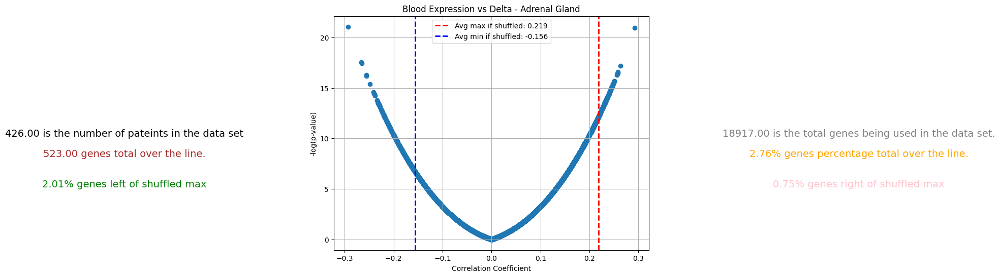

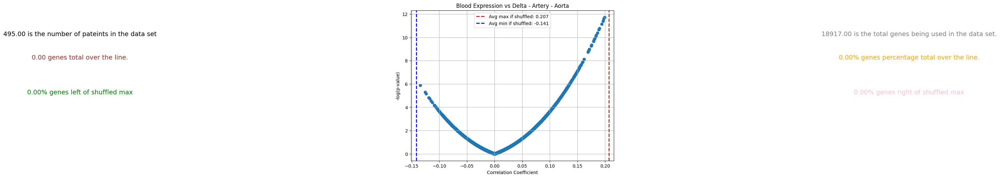

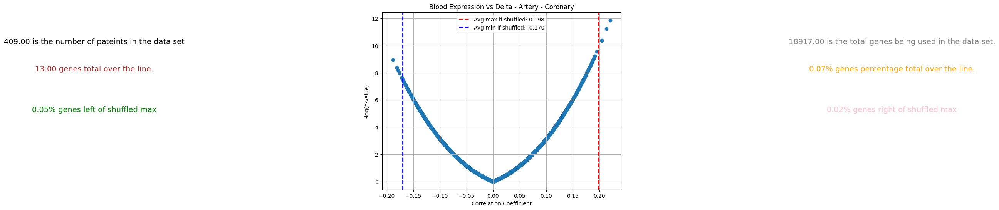

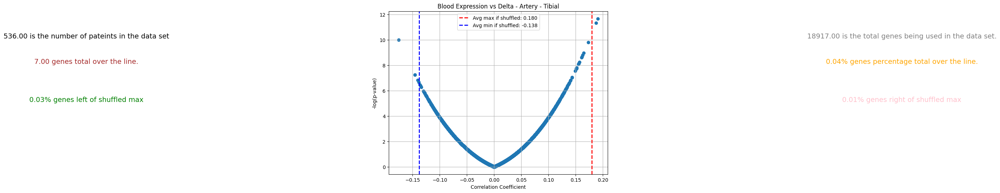

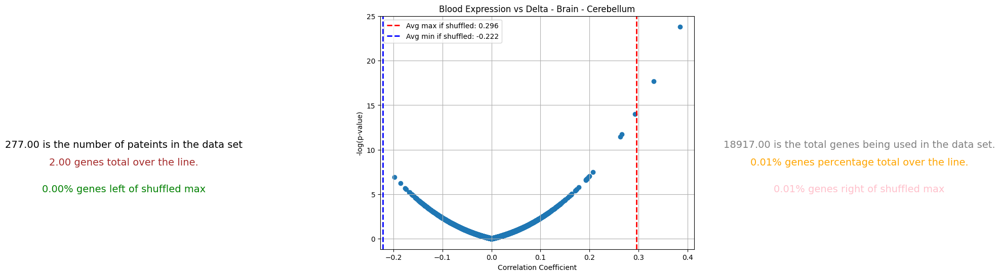

...

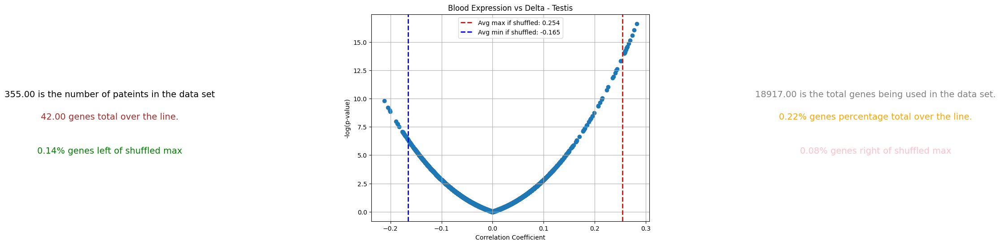

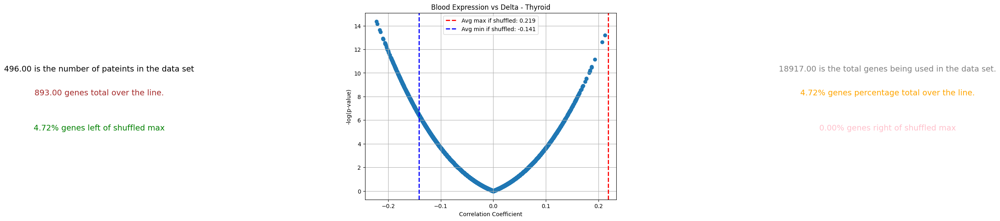

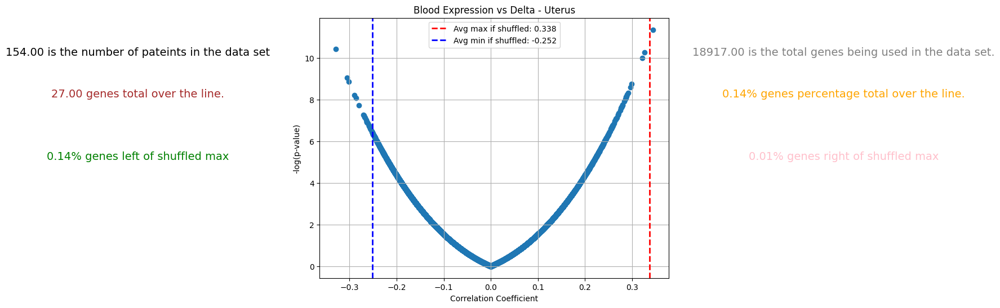

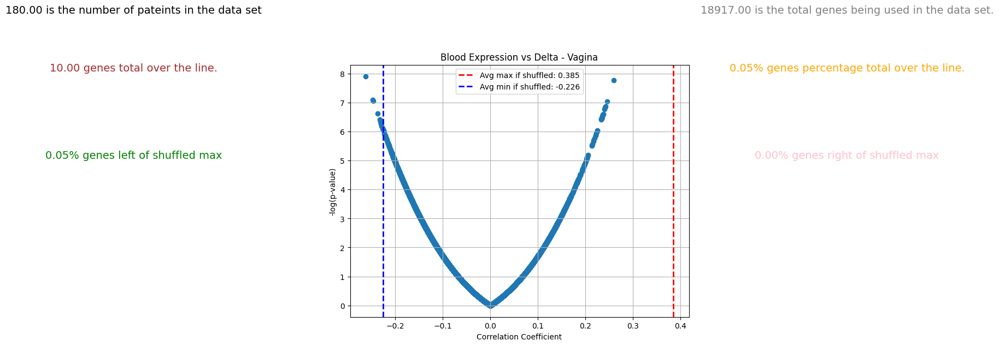

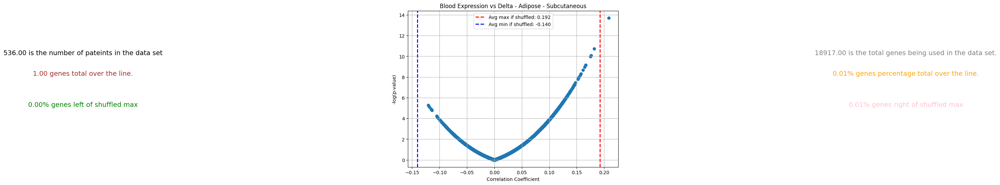

 Showing plot for: Adrenal Gland


<Figure size 640x480 with 0 Axes>

 Showing plot for: Artery - Aorta


<Figure size 640x480 with 0 Axes>

 Showing plot for: Artery - Coronary


<Figure size 640x480 with 0 Axes>

 Showing plot for: Artery - Tibial


<Figure size 640x480 with 0 Axes>

 Showing plot for: Brain - Cerebellum


<Figure size 640x480 with 0 Axes>

 Showing plot for: Brain - Cortex


<Figure size 640x480 with 0 Axes>

 Showing plot for: Breast - Mammary Tissue


<Figure size 640x480 with 0 Axes>

 Showing plot for: Colon - Sigmoid


<Figure size 640x480 with 0 Axes>

 Showing plot for: Colon - Transverse


<Figure size 640x480 with 0 Axes>

 Showing plot for: Esophagus - Gastroesophageal Junction


<Figure size 640x480 with 0 Axes>

 Showing plot for: Esophagus - Mucosa


<Figure size 640x480 with 0 Axes>

 Showing plot for: Esophagus - Muscularis


<Figure size 640x480 with 0 Axes>

 Showing plot for: Heart - Atrial Appendage


<Figure size 640x480 with 0 Axes>

 Showing plot for: Heart - Left Ventricle


<Figure size 640x480 with 0 Axes>

 Showing plot for: Kidney - Cortex


<Figure size 640x480 with 0 Axes>

 Showing plot for: Liver


<Figure size 640x480 with 0 Axes>

 Showing plot for: Lung


<Figure size 640x480 with 0 Axes>

 Showing plot for: Muscle - Skeletal


<Figure size 640x480 with 0 Axes>

 Showing plot for: Nerve - Tibial


<Figure size 640x480 with 0 Axes>

 Showing plot for: Ovary


<Figure size 640x480 with 0 Axes>

 Showing plot for: Pancreas


<Figure size 640x480 with 0 Axes>

 Showing plot for: Pituitary


<Figure size 640x480 with 0 Axes>

 Showing plot for: Prostate


<Figure size 640x480 with 0 Axes>

 Showing plot for: Small Intestine - Terminal Ileum


<Figure size 640x480 with 0 Axes>

 Showing plot for: Spleen


<Figure size 640x480 with 0 Axes>

 Showing plot for: Stomach


<Figure size 640x480 with 0 Axes>

 Showing plot for: Testis


<Figure size 640x480 with 0 Axes>

 Showing plot for: Thyroid


<Figure size 640x480 with 0 Axes>

 Showing plot for: Uterus


<Figure size 640x480 with 0 Axes>

 Showing plot for: Vagina


<Figure size 640x480 with 0 Axes>

In [16]:
analyze_tissues()

In [ ]:
def analyze_specific_tissues():
    import pandas as pd
    import matplotlib.pyplot as plt

    # Load delta data once
    delta_data = pd.read_csv('/shares/sinha/epallapotu/blood_expression_project/all_tissues_delta_scores.tsv', sep='\t')
    unique_tissues = delta_data["tissue"].unique()
    print(f"These are the unique tissues found:\n{unique_tissues}\n")

    # List of tissues to analyze
    tissue_list = ["Brain - Cerebellum"]
    plot_list = []
    
    for tissue in tissue_list:
        if tissue not in unique_tissues:
            print(f"Tissue '{tissue}' not found in dataset. Skipping.")
            continue

        print(f"\n--- Running analysis for tissue: {tissue} ---")
        try:
            fig, df_final_results, avg_max_shuffle, avg_min_shuffle = tissue_analysis(tissue)
            if fig is not None:
                plot_list.append((tissue, fig))
            else:
                print(f" No figure returned for tissue '{tissue}'.")
        except Exception as e:
            print(f"Error processing tissue '{tissue}': {e}")
        
        output_dir = f"{tissue}_analysis_results"
        os.makedirs(output_dir, exist_ok=True)
        fig_path = os.path.join(output_dir, f"{tissue}_correlation_plot.png")
        fig.savefig(fig_path)
        print(f"Saved plot to {fig_path}")

        # Save the dataframe
        csv_path = os.path.join(output_dir, f"{tissue}_correlation_results.csv")
        df_final_results.to_csv(csv_path, index=False)
        print(f"Saved results to {csv_path}")

        # Save summary stats
        stats_path = os.path.join(output_dir, f"{tissue}_summary.txt")
        with open(stats_path, 'w') as f:
            f.write(f"Tissue: {tissue}\n")
            f.write(f"Avg Max Shuffle: {avg_max_shuffle:.4f}\n")
            f.write(f"Avg Min Shuffle: {avg_min_shuffle:.4f}\n")
            f.write(f"Total genes: {len(df_final_results)}\n")
        print(f"Saved summary to {stats_path}")
    # Show all collected plots
    for tissue, fig in plot_list:
        print(f" Showing plot for: {tissue}")
        plt.figure(fig.number)
        plt.show()


These are the unique tissues found:
['Adipose - Subcutaneous' 'Adrenal Gland' 'Artery - Aorta'
 'Artery - Coronary' 'Artery - Tibial' 'Brain - Cerebellum'
 'Brain - Cortex' 'Breast - Mammary Tissue' 'Colon - Sigmoid'
 'Colon - Transverse' 'Esophagus - Gastroesophageal Junction'
 'Esophagus - Mucosa' 'Esophagus - Muscularis' 'Heart - Atrial Appendage'
 'Heart - Left Ventricle' 'Kidney - Cortex' 'Liver' 'Lung'
 'Muscle - Skeletal' 'Nerve - Tibial' 'Ovary' 'Pancreas' 'Pituitary'
 'Prostate' 'Small Intestine - Terminal Ileum' 'Spleen' 'Stomach' 'Testis'
 'Thyroid' 'Uterus' 'Vagina']


--- Running analysis for tissue: Brain - Cerebellum ---


/tmp/ipykernel_3784806/985918198.py:14: DtypeWarning: Columns (35,38,45,48,49) have mixed types. Specify dtype option on import or set low_memory=False.
  protein_data = pd.read_csv(protein_file, sep='\t')
/tmp/ipykernel_3784806/985918198.py:29: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  .groupby(level=0, axis=1)
  5%|▍         | 871/18917 [00:00<00:05, 3212.99it/s]/tmp/ipykernel_3784806/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
 12%|█▏        | 2285/18917 [00:00<00:04, 4053.23it/s]/tmp/ipykernel_3784806/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
/tmp/ipykernel_3784806/2240724213.py:15: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p = pearsonr(x, y)
 14%|█▍        | 2692/189

[(np.float64(0.24638020708508018), np.float64(-0.1939802831411761)), (np.float64(0.26097514993397), np.float64(-0.22025029708205304)), (np.float64(0.30771435628291577), np.float64(-0.2148139334534161)), (np.float64(0.2955518753232693), np.float64(-0.18911849653007923)), (np.float64(0.29555187532326926), np.float64(-0.2435413991074736)), (np.float64(0.2998388790600021), np.float64(-0.26253893569392805)), (np.float64(0.31666722282490645), np.float64(-0.22670131817190844)), (np.float64(0.31476745621056207), np.float64(-0.27717323649414444)), (np.float64(0.21677384233690136), np.float64(-0.21103618629047705)), (np.float64(0.26311661914273343), np.float64(-0.2177456405269527)), (np.float64(0.25465140366648065), np.float64(-0.2690721582829424)), (np.float64(0.3155045642521477), np.float64(-0.22199811860097607)), (np.float64(0.2955518753232693), np.float64(-0.2071665679183141)), (np.float64(0.33621216510000573), np.float64(-0.22670131817190844)), (np.float64(0.25889985288934203), np.float64(-

/tmp/ipykernel_3784806/4144870856.py:125: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  fig.tight_layout()


Saved plot to Brain - Cerebellum_analysis_results/Brain - Cerebellum_correlation_plot.png
Saved results to Brain - Cerebellum_analysis_results/Brain - Cerebellum_correlation_results.csv
Saved summary to Brain - Cerebellum_analysis_results/Brain - Cerebellum_summary.txt
 Showing plot for: Brain - Cerebellum


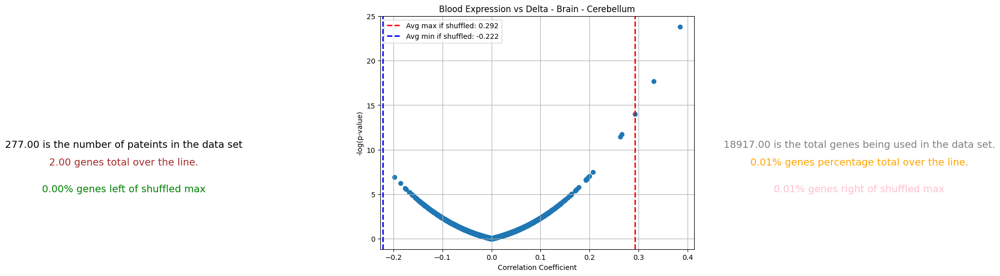

In [ ]:
def initialize_data(tissue_type):
    #corrected
    import pandas as pd
    import numpy as np

# Paths to input files
    blood_file = '/shares/sinha/epallapotu/blood_expression_project/gene_tpm_v10_whole_blood.gct.gz'
    protein_file = '/shares/sinha/epallapotu/blood_expression_project/gene_with_protein_product.txt'
    delta_file = '/shares/sinha/epallapotu/blood_expression_project/all_tissues_delta_scores.tsv'

    # Load data
    protein_data = pd.read_csv(protein_file, sep='\t')
    blood_data = pd.read_csv(blood_file, sep='\t', compression='gzip', skiprows=2)

    # Keep only genes present in both protein list and blood data
    common_genes = np.intersect1d(protein_data["symbol"], blood_data["Description"])
    blood_protein_data = blood_data[blood_data['Description'].isin(common_genes)]

    # Truncate column names (patient IDs) to first 9 characters
    blood_protein_data.columns = [col[:9] if len(col) >= 9 else col for col in blood_protein_data.columns]
    blood_protein_data = blood_protein_data.rename(columns={'Descripti': 'Description'})  # Fix truncation from previous line

    # Resolve duplicate patient columns by averaging
    blood_protein_data = (
        blood_protein_data
        .set_index(['Name', 'Description'])
        .groupby(level=0, axis=1)
        .mean()
        .reset_index()
    )

    # Read and process delta data
    delta_data = pd.read_csv(delta_file, sep='\t')
    delta_data["Patients"] = delta_data["sample_id"].str[:9]
    delta_data = delta_data.drop(columns='sample_id')
    tissue_data = delta_data[delta_data["tissue"] == (tissue_type)]

    return blood_protein_data, tissue_data, protein_data, delta_data

In [ ]:
import numpy as np
import random
from scipy.stats import pearsonr

def shuffle_and_compute(args):
    count, blood_protein_data_filtered, original_data2 = args
    shuffled_data2 = original_data2.copy()
    random.shuffle(shuffled_data2)

    random_pearson_list = []
    for _, row in blood_protein_data_filtered.iterrows():
        data1 = row.values
        mask = np.isfinite(data1) & np.isfinite(shuffled_data2)
        data1 = data1[mask]
        data2 = shuffled_data2[mask]
        if len(data1) < 2 or np.std(data1) == 0 or np.std(data2) == 0:
            continue
        try:
            corr, _ = pearsonr(data1, data2)
            random_pearson_list.append(corr)
        except Exception:
            continue

    if random_pearson_list:
        return max(random_pearson_list), min(random_pearson_list)
    else:
        return None

In [ ]:

from scipy.stats import pearsonr
import numpy as np

def compute_pearson(args):
    index, row, data2, name, description = args

    # Remove NaNs from both vectors
    valid_mask = (~np.isnan(row)) & (~np.isnan(data2))
    x = row[valid_mask]
    y = data2[valid_mask]

    try:
        if len(x) < 2:
            return None
        corr, p = pearsonr(x, y)
        return {
            'Pearson': corr,
            'P_value': p,
            'Name': name,
            'Description': description,
        }
    except Exception:
        return None